<a href="https://colab.research.google.com/github/AndSiq97/COVID-19-Healthy-Diet/blob/master/Protein_Supply_Quantity_COVID_19_Health_Diet_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib 
import seaborn as sns
import os
%matplotlib inline
import matplotlib.style as style

In [2]:
# Uncomment this cell, Run this, comment cell, restart runtime and run everything else
# !pip install --upgrade matplotlib

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"
# /content/gdrive/My Drive/Kaggle is the path where kaggle.json is present in the Google Drive

#changing the working directory
%cd /content/gdrive/My Drive/Kaggle
#Check the present working directory using pwd command

Mounted at /content/gdrive
/content/gdrive/My Drive/Kaggle


Load Datasets

In [4]:
# Reading some csv files
protein_supply_quantity_data = pd.read_csv("/content/gdrive/MyDrive/Protein_Supply_Quantity_Data.csv")
supply_food_descriptions_data = pd.read_csv("/content/gdrive/MyDrive/Supply_Food_Data_Descriptions.csv")

Food Supply Descriptions Data

In [5]:
# Checking first 5 rows of Supply Food Descriptions dataframe
supply_food_descriptions_data.head()

,Categories,Items
0,Alcoholic Beverages,"Alcohol, Non-Food; Beer; Beverages, Alcoholic;..."
1,Animal fats,"Butter, Ghee; Cream; Fats, Animals, Raw; Fish,..."
2,Animal Products,"Aquatic Animals, Others; Aquatic Plants; Bovin..."
3,"Aquatic Products, Other","Aquatic Animals, Others; Aquatic Plants; Meat,..."
4,Cereals - Excluding Beer,"Barley and products; Cereals, Other; Maize and..."


Protein Supply Quantity Data

In [7]:
# Checking first 5 rows of Protein Supply Quantity dataframe
protein_supply_quantity_data.head()

,Country,Alcoholic Beverages,Animal Products,Animal fats,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Milk - Excluding Butter,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar Crops,Sugar & Sweeteners,Treenuts,Vegetal Products,Vegetable Oils,Vegetables,Miscellaneous,Obesity,Undernourished,Confirmed,Deaths,Recovered,Active,Population,Unit (all except Population)
0,Afghanistan,0.0000,9.7523,0.0277,0.0,35.9771,0.4067,0.0647,0.5824,3.1337,5.5278,0.5916,0.2034,1.2479,0.1664,0.1941,0.5546,0.0,0.0000,0.1387,40.2477,0.0000,1.1370,0.0462,4.5,29.8,0.005707,0.000168,0.000683,0.004855,38042000.0,%
1,Albania,0.1840,27.7469,0.0711,0.0,14.2331,1.8069,0.6274,1.2757,7.6582,16.4750,1.1084,0.3722,1.4555,0.0000,0.8867,0.2635,0.0,0.0042,0.2677,22.2552,0.0084,3.2456,0.0544,22.3,6.2,0.027047,0.001085,0.016445,0.009517,2858000.0,%
2,Algeria,0.0323,13.8360,0.0054,0.0,26.5633,1.2916,0.6350,1.1624,3.5088,8.0616,0.3283,0.1830,2.5509,0.1776,1.4638,0.4628,0.0,0.0000,0.2745,36.1694,0.0269,3.1267,0.1399,26.6,3.9,0.009229,0.001037,0.004099,0.004094,43406000.0,%
3,Angola,0.6285,15.2311,0.0277,0.0,20.3882,0.1756,5.4436,1.2754,7.6248,1.1460,0.8133,2.1534,4.0850,0.0000,5.1941,0.1017,0.0,0.0092,0.0092,34.7782,0.0092,0.8133,0.0924,6.8,25,0.000086,0.000006,0.000022,0.000057,31427000.0,%
4,Antigua and Barbuda,0.1535,33.1901,0.1289,0.0,10.5108,0.4850,8.2146,1.2586,16.0670,7.4349,0.8534,0.7674,0.8841,0.3438,0.4666,0.4113,0.0,0.0000,0.0737,16.8161,0.0430,1.6024,0.2947,19.1,NaN,0.024742,0.003093,0.011340,0.010309,97000.0,%


In [8]:
# Names of Columns in DataFrame
protein_supply_quantity_data.columns

Index(['Country', 'Alcoholic Beverages', 'Animal Products', 'Animal fats',
       'Aquatic Products, Other', 'Cereals - Excluding Beer', 'Eggs',
       'Fish, Seafood', 'Fruits - Excluding Wine', 'Meat',
       'Milk - Excluding Butter', 'Offals', 'Oilcrops', 'Pulses', 'Spices',
       'Starchy Roots', 'Stimulants', 'Sugar Crops', 'Sugar & Sweeteners',
       'Treenuts', 'Vegetal Products', 'Vegetable Oils', 'Vegetables',
       'Miscellaneous', 'Obesity', 'Undernourished', 'Confirmed', 'Deaths',
       'Recovered', 'Active', 'Population', 'Unit (all except Population)'],
      dtype='object')

In [9]:
# Checking size/shape of DataFrame
protein_supply_quantity_data.shape

(170, 32)

In [10]:
# Data Info
protein_supply_quantity_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170 entries, 0 to 169
Data columns (total 32 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Country                       170 non-null    object 
 1   Alcoholic Beverages           170 non-null    float64
 2   Animal Products               170 non-null    float64
 3   Animal fats                   170 non-null    float64
 4   Aquatic Products, Other       170 non-null    float64
 5   Cereals - Excluding Beer      170 non-null    float64
 6   Eggs                          170 non-null    float64
 7   Fish, Seafood                 170 non-null    float64
 8   Fruits - Excluding Wine       170 non-null    float64
 9   Meat                          170 non-null    float64
 10  Milk - Excluding Butter       170 non-null    float64
 11  Offals                        170 non-null    float64
 12  Oilcrops                      170 non-null    float64
 13  Pulse

In [11]:
# Weird that Undernourished Rate (as %) is not a float type so we'll change that
import re
import random

# random number for Undernourished values < 2.5 to reduce bias 
def random_number(integer):
  if integer == 2.5:
    return random.uniform(0.0, 2.5)
  return integer

protein_supply_quantity_data['Undernourished'] = protein_supply_quantity_data['Undernourished'].apply(lambda string: re.compile(r'[^\d.]+').sub('', str(string))) 
protein_supply_quantity_data['Undernourished'] = pd.to_numeric(protein_supply_quantity_data['Undernourished'], errors='coerce')
protein_supply_quantity_data['Undernourished'] = protein_supply_quantity_data['Undernourished'].apply(lambda integer: random_number(integer)) 

In [12]:
# Basic statistics to describe DataFrame
protein_supply_quantity_data.describe()

,Alcoholic Beverages,Animal Products,Animal fats,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Milk - Excluding Butter,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar Crops,Sugar & Sweeteners,Treenuts,Vegetal Products,Vegetable Oils,Vegetables,Miscellaneous,Obesity,Undernourished,Confirmed,Deaths,Recovered,Active,Population
count,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,167.000000,163.000000,160.000000,160.000000,160.000000,160.000000,1.700000e+02
mean,0.262809,21.232152,0.108229,0.009219,19.024928,1.161468,3.355785,0.840909,9.902964,5.921159,0.773435,1.369330,2.656114,0.231802,1.744087,0.441233,0.004078,0.009199,0.243648,28.768171,0.020805,1.736618,0.181846,18.707784,10.900899,0.058884,0.003343,0.025432,0.030158,4.408395e+07
std,0.244381,7.921757,0.150429,0.082953,6.450422,0.787300,2.877043,0.640846,4.689060,3.927008,0.549329,1.490287,2.938678,0.328785,1.896152,0.388007,0.015128,0.042180,0.282933,7.921684,0.023578,1.002899,0.223780,9.633557,12.153696,0.104288,0.009448,0.067907,0.052592,1.556265e+08
min,0.000000,4.456100,0.000000,0.000000,7.808100,0.042700,0.064700,0.059100,1.017900,0.264400,0.000000,0.009700,0.000000,0.000000,0.133200,0.014200,0.000000,0.000000,0.000000,14.215800,0.000000,0.163100,0.000000,2.100000,0.019781,0.000021,0.000000,0.000000,0.000010,5.300000e+04
25%,0.066075,14.461225,0.022975,0.000000,13.676400,0.433650,1.341850,0.477675,5.956775,2.419325,0.429425,0.379450,0.667825,0.042800,0.647550,0.201200,0.000000,0.000000,0.045100,21.699600,0.005225,0.986875,0.033050,8.500000,2.226619,0.003070,0.000055,0.000726,0.001078,2.822750e+06
50%,0.198250,21.852950,0.056250,0.000000,17.568900,1.119100,2.602350,0.695150,10.212900,5.602350,0.676700,0.795050,1.676100,0.112850,1.065650,0.352300,0.000000,0.000000,0.158050,28.152600,0.015250,1.502450,0.100800,21.200000,6.800000,0.013152,0.000336,0.003517,0.006543,1.014600e+07
75%,0.381575,28.299000,0.122350,0.000000,23.901975,1.676250,4.525075,0.982125,13.325075,8.501675,0.947850,1.785375,3.664650,0.312150,1.960175,0.598475,0.000000,0.005050,0.327650,35.541925,0.028450,2.068075,0.227900,25.700000,14.600000,0.068110,0.001683,0.018089,0.032337,3.169250e+07
max,1.366000,35.786000,0.980700,1.071900,35.977100,3.573500,18.078900,4.649400,21.625000,16.475000,3.501600,8.064900,18.247800,1.860400,10.967200,2.582400,0.129800,0.469900,1.891300,45.551500,0.113500,5.054600,1.184100,45.600000,59.600000,0.610323,0.066277,0.518226,0.266797,1.398030e+09


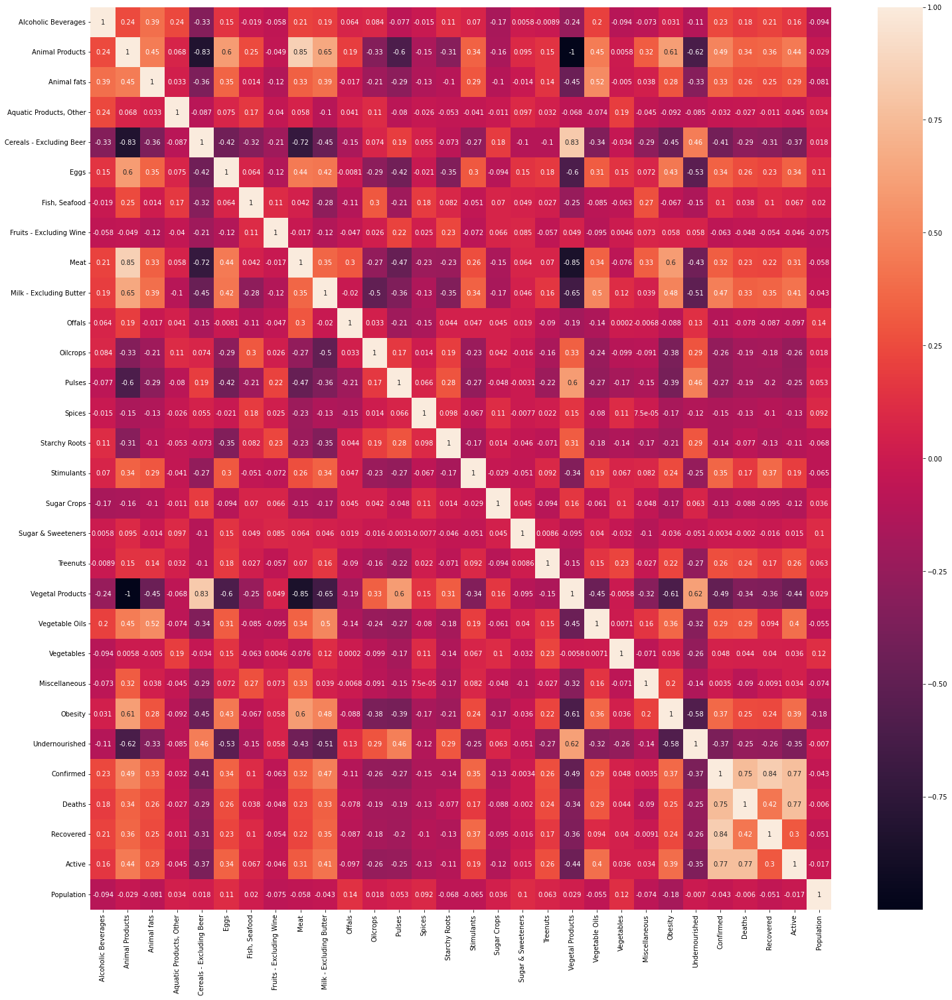

In [13]:
# Correlation Matrix (Works Only for Regression Variables)
fig, ax = plt.subplots(figsize=(25,25)) 
corrMatrix = protein_supply_quantity_data.corr()
sns.heatmap(corrMatrix, annot=True, ax=ax)
plt.show()

In [14]:
# List of ALL Health Diet Intakes 
health_diet_intakes = ['Alcoholic Beverages', 'Animal Products', 'Animal fats', 'Aquatic Products, Other', 'Cereals - Excluding Beer', 'Eggs', 'Fish, Seafood', 'Fruits - Excluding Wine', 
                       'Meat', 'Miscellaneous', 'Milk - Excluding Butter', 'Offals', 'Oilcrops', 'Pulses', 'Spices', 'Starchy Roots', 'Stimulants', 'Sugar Crops', 'Sugar & Sweeteners',
                       'Treenuts', 'Vegetal Products', 'Vegetable Oils', 'Vegetables']

Relationship Between ALL Health Diet Protein Intakes Percentage and Obesity Percentage

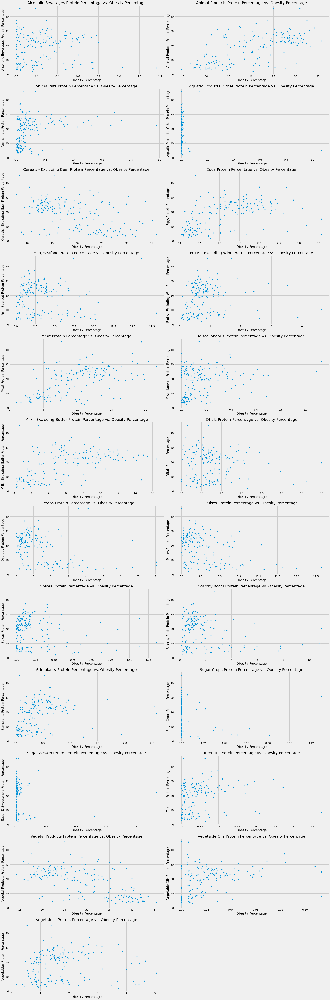

In [21]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Obesity', 
            data = protein_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Protein Percentage vs. Obesity Percentage"
  x_title = "Obesity Percentage"
  y_title = intake + " Protein Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Protein Intakes Percentage and Undernourished Percentage

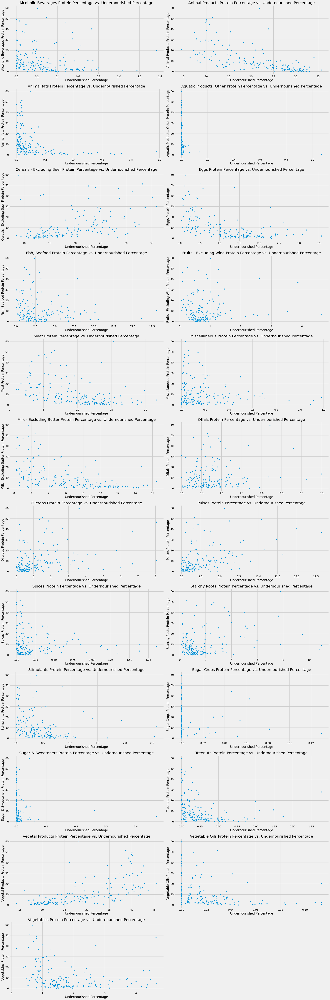

In [25]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Undernourished', 
            data = protein_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Protein Percentage vs. Undernourished Percentage"
  x_title = "Undernourished Percentage"
  y_title = intake + " Protein Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Protein Intakes Percentage and Confirmed Cases of COVID-19 Percentage

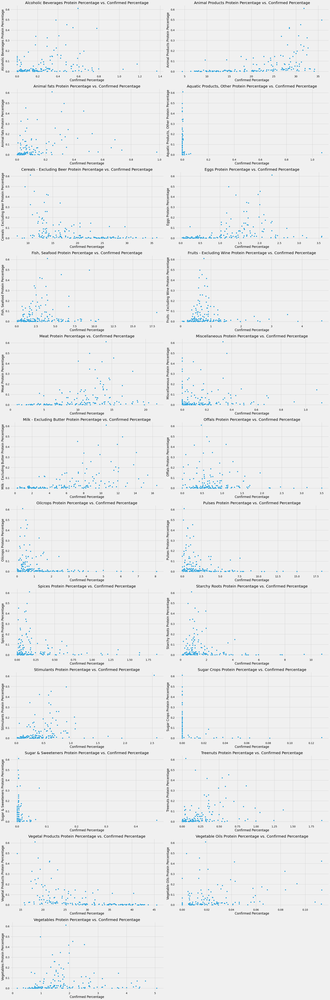

In [23]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Confirmed', 
            data = protein_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Protein Percentage vs. Confirmed Percentage"
  x_title = "Confirmed Percentage"
  y_title = intake + " Protein Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Protein Intakes Percentage and Death from COVID-19 Percentage

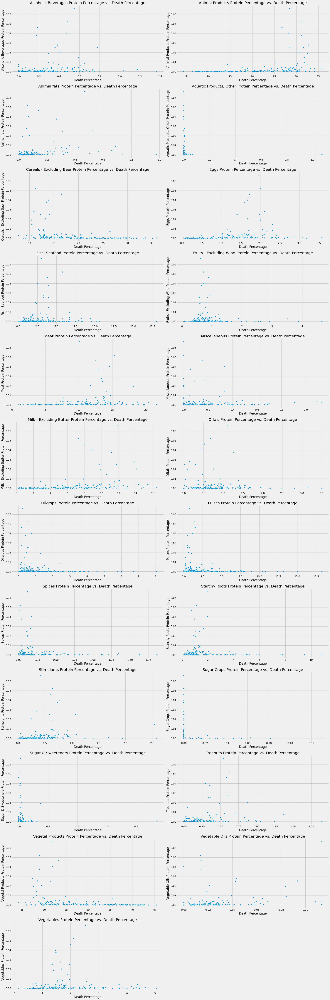

In [24]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Deaths', 
            data = protein_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Protein Percentage vs. Death Percentage"
  x_title = "Death Percentage"
  y_title = intake + " Protein Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Protein Intakes Percentage and Recovery from COVID-19 Percentage

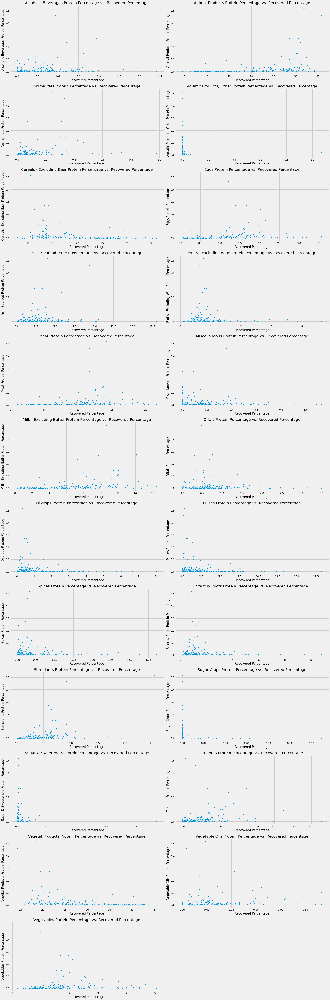

In [26]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Recovered', 
            data = protein_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Protein Percentage vs. Recovered Percentage"
  x_title = "Recovered Percentage"
  y_title = intake + " Protein Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Protein Intakes Percentage and Active Cases of COVID-19 Percentage

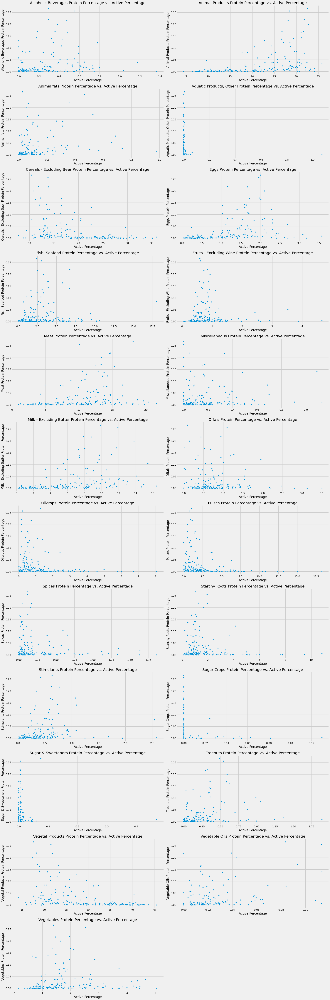

In [27]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Active', 
            data = protein_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Protein Percentage vs. Active Percentage"
  x_title = "Active Percentage"
  y_title = intake + " Protein Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Obesity Percentage and ALL of Confirmed, Death, Recovered, and Active Percentages of COVID-19

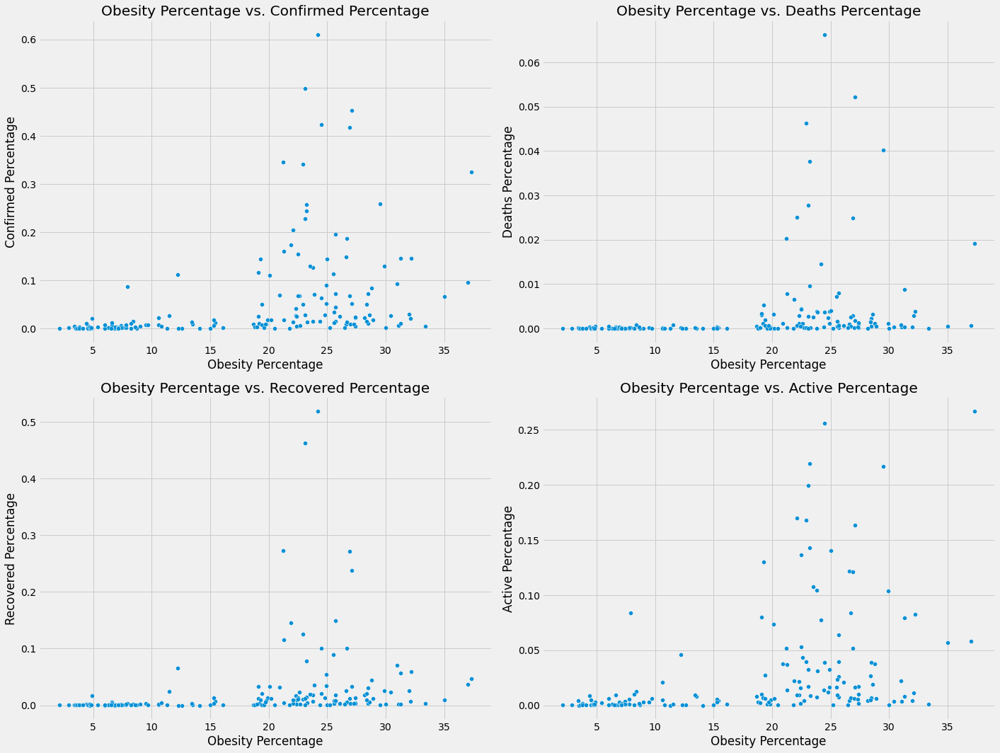

In [28]:
a = 2  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(20,15))
for target in ['Confirmed', 'Deaths', 'Recovered', 'Active']:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = 'Obesity', y = target, 
            data = protein_supply_quantity_data)
  style.use('fivethirtyeight')
  title = "Obesity Percentage vs. " + target + " Percentage"
  x_title = "Obesity Percentage"
  y_title = target + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Undernourished Percentage and ALL of Confirmed, Death, Recovered, and Active Percentages of COVID-19

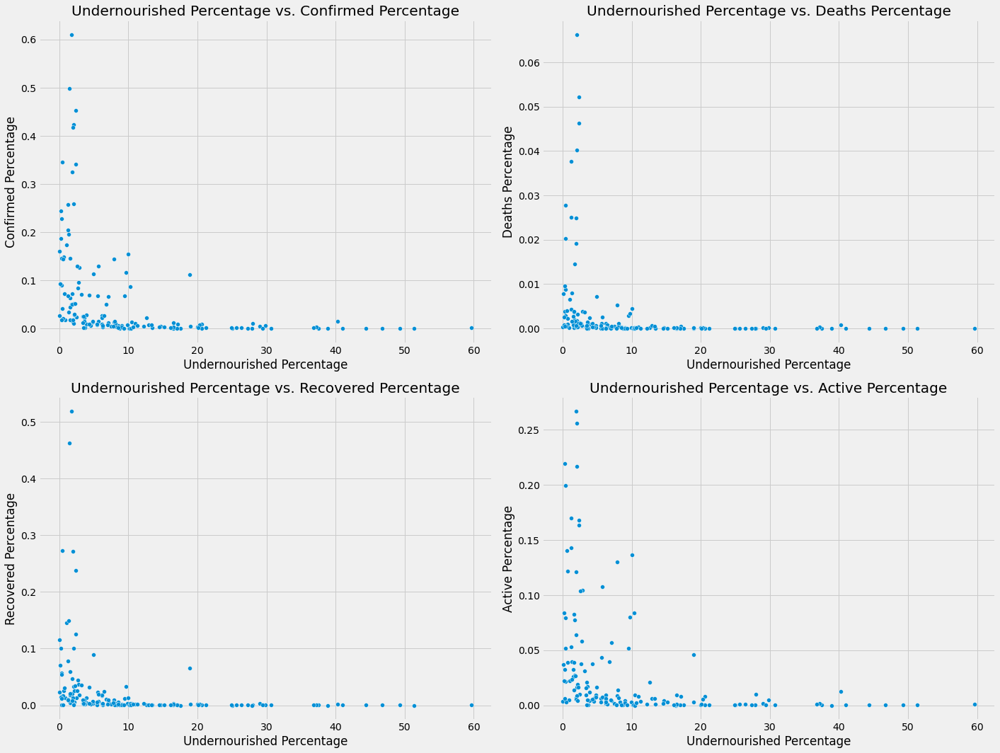

In [29]:
a = 2  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(20,15))
for target in ['Confirmed', 'Deaths', 'Recovered', 'Active']:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = 'Undernourished', y = target, 
            data = protein_supply_quantity_data)
  style.use('fivethirtyeight')
  title = "Undernourished Percentage vs. " + target + " Percentage"
  x_title = "Undernourished Percentage"
  y_title = target + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Confirmed Cases of COVID-19 Percentages Between Countries

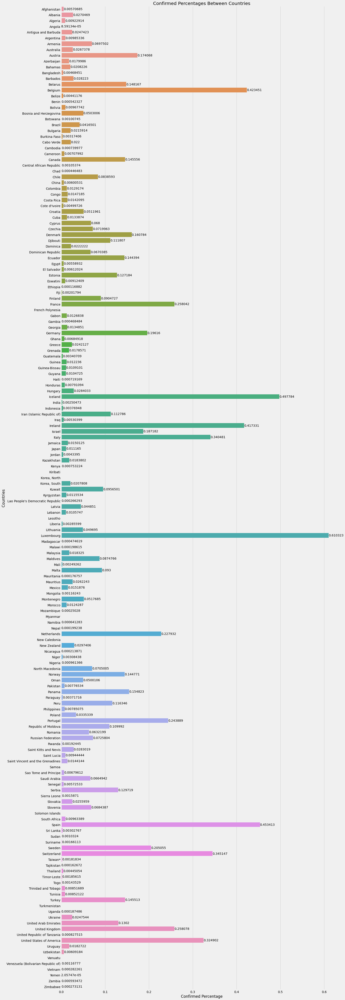

In [30]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Confirmed', y = 'Country', data = protein_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Confirmed Percentages Between Countries"
plt.title(title)
plt.xlabel("Confirmed Percentage")
plt.ylabel("Countries")
plt.show()

Death From COVID-19 Percentages Between Countries

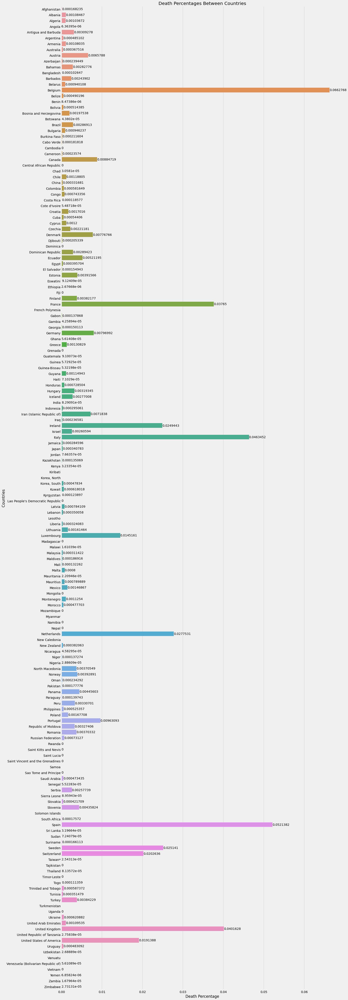

In [32]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Deaths', y = 'Country', data = protein_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Death Percentages Between Countries"
plt.title(title)
plt.xlabel("Death Percentage")
plt.ylabel("Countries")
plt.show()

Recovered from COVID-19 Percentages Between Countries

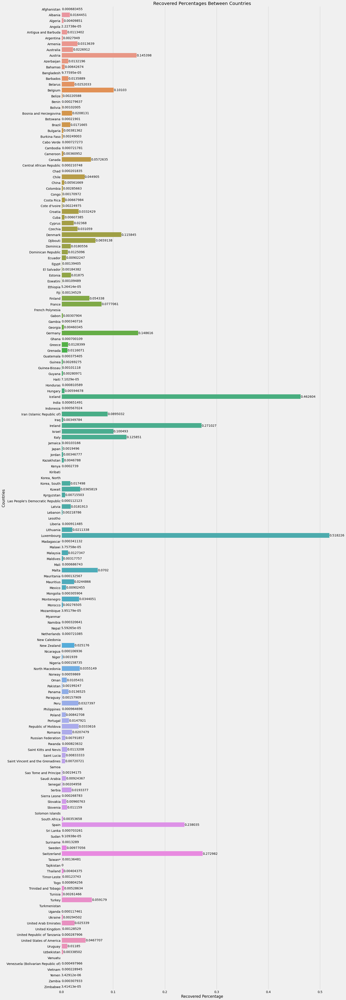

In [31]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Recovered', y = 'Country', data = protein_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Recovered Percentages Between Countries"
plt.title(title)
plt.xlabel("Recovered Percentage")
plt.ylabel("Countries")
plt.show()

Active Cases of COVID-19 Percentages Between Countries

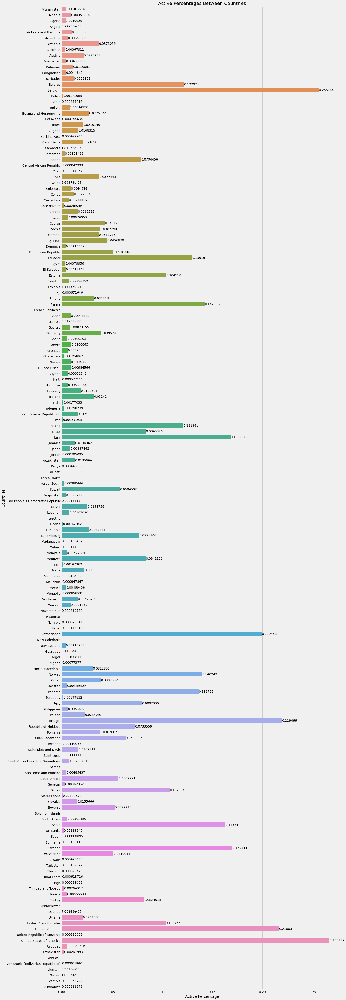

In [33]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Active', y = 'Country', data = protein_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Active Percentages Between Countries"
plt.title(title)
plt.xlabel("Active Percentage")
plt.ylabel("Countries")
plt.show()

ALL Health Diet Protein Intakes Percentages Between Countries

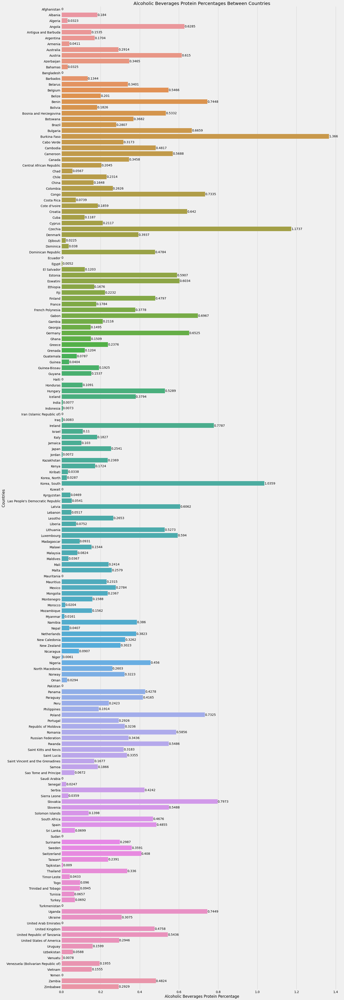

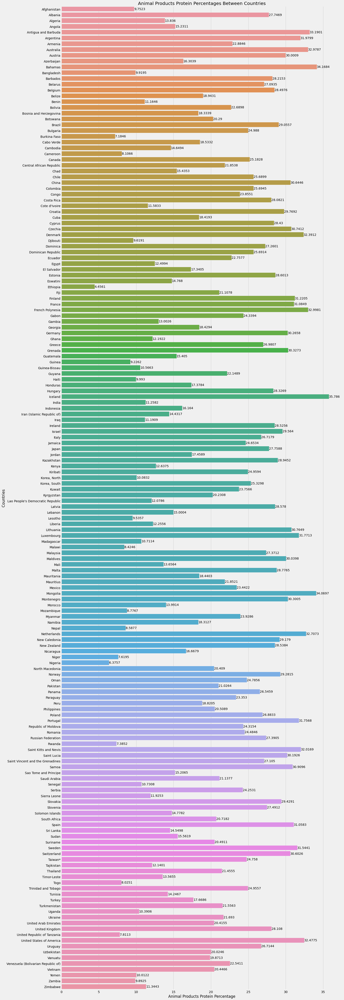

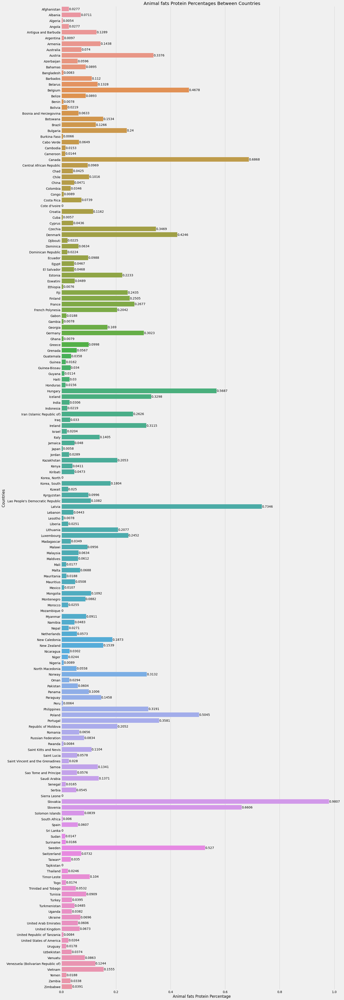

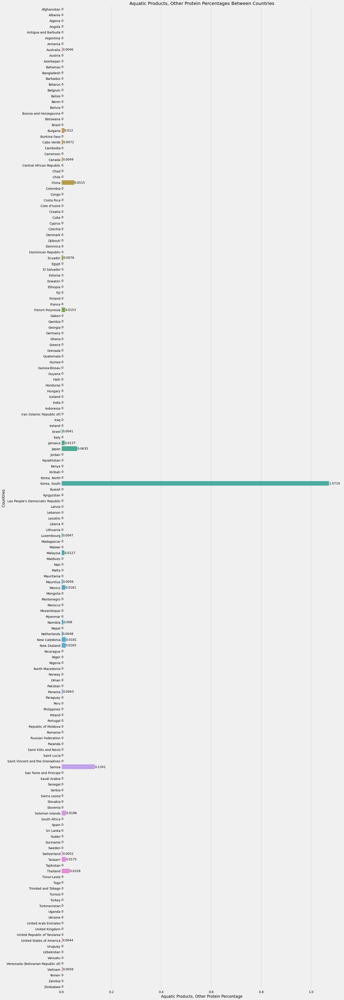

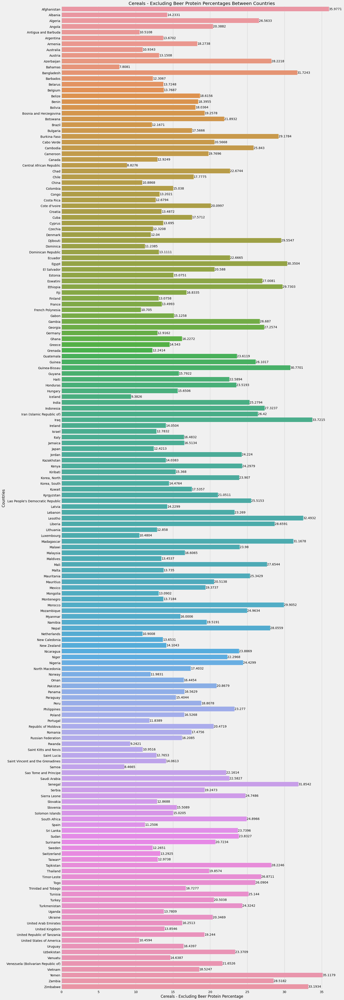

...

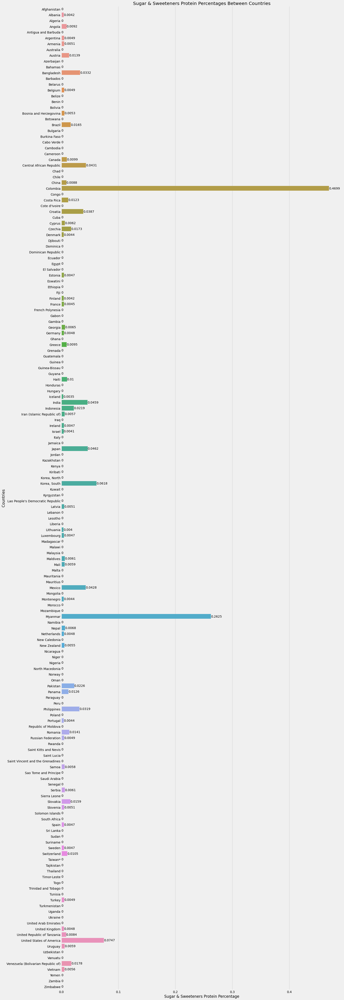

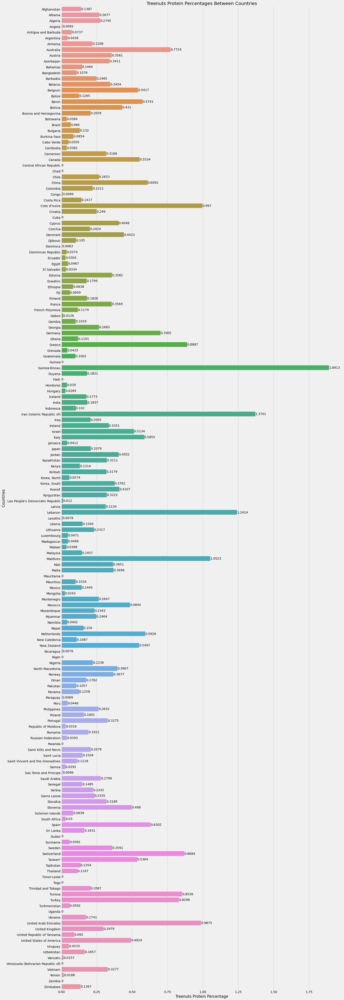

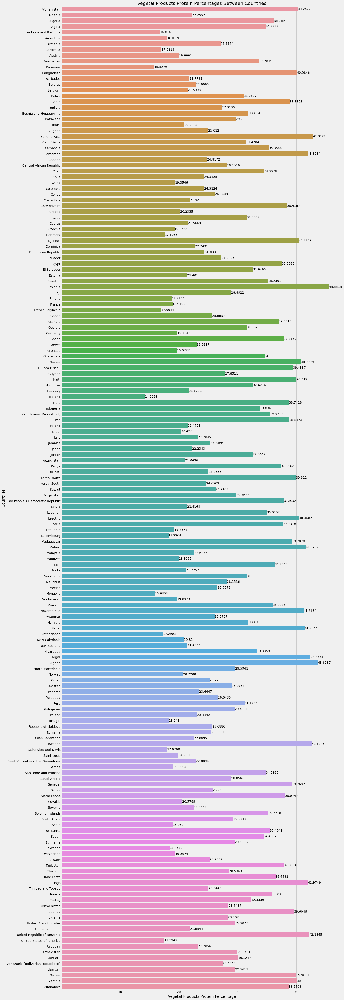

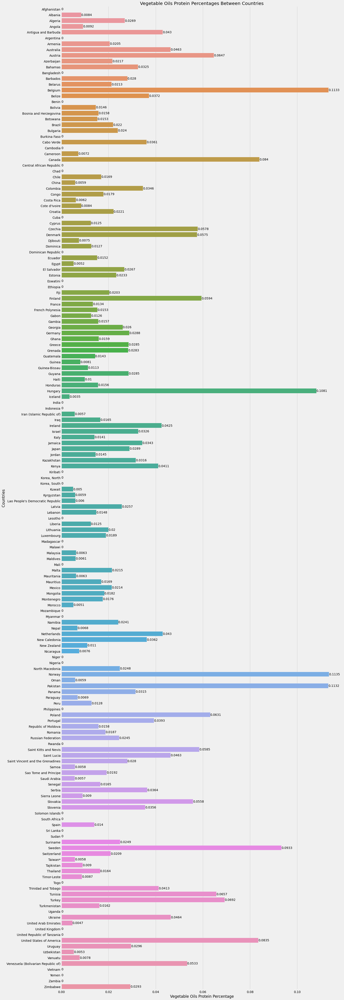

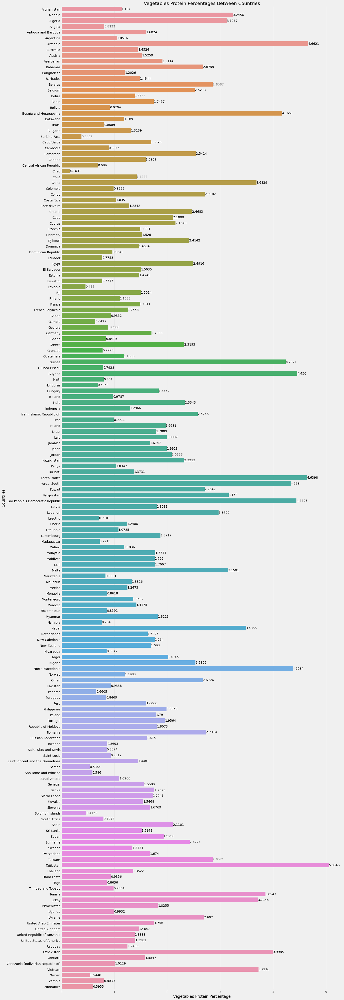

In [35]:
for intake in health_diet_intakes:
  fig, ax = plt.subplots(figsize=(20, 75))
  sns.barplot(x = intake, y = 'Country', data = protein_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
  ax.bar_label(ax.containers[-1], label_type='edge')
  style.use('fivethirtyeight')
  title = intake + " Protein Percentages Between Countries"
  x_title = intake + " Protein Percentage"
  y_title = "Countries"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  plt.show()
  print("          ")
  print("          ")